based on paper: https://arxiv.org/pdf/1711.06753.pdf

In [1]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import sys
sys.path.insert(0, '../')

In [4]:
os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'

# Training using the ResNet topology

In [5]:
from cpe775.networks.resnet import resnet18

In [6]:
net = resnet18(in_shape=(-1, 1, 256, 256), out_shape=(-1, 68, 2))

## Loading the dataset and splitting between train and valid

In [7]:
from cpe775.dataset import FaceLandmarksDataset, CroppedFaceLandmarksDataset
from torch.utils.data.sampler import SubsetRandomSampler
from torchvision.transforms import Compose
from cpe775.transforms import ToTensor, CropFace, ToGray, RandomHorizontalFlip, ToPILImage, RandomCrop, CenterCrop

In [8]:
batch_size = 128
random_seed = 42
valid_size = 0.2
shuffle = True

In [9]:
train_transforms = Compose([
                   ToPILImage(),
                   RandomCrop((224,224)),
                   RandomHorizontalFlip(),
                   ToGray(),
                   ToTensor()
                 ])

transforms = Compose([
                   ToPILImage(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [10]:
# load the dataset
train_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=train_transforms)
valid_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=transforms)

num_train = len(train_dataset)
indices = list(range(num_train))
split = int(np.floor(valid_size * num_train))

if shuffle == True:
    np.random.seed(random_seed)
    np.random.shuffle(indices)

train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

train_loader = torch.utils.data.DataLoader(train_dataset, 
                batch_size=batch_size, sampler=train_sampler, num_workers=4)

valid_loader = torch.utils.data.DataLoader(valid_dataset, 
                batch_size=batch_size, sampler=valid_sampler, num_workers=4)

## Creating the model

In [11]:
net = torch.nn.DataParallel(net)
net = net.cuda()

In [12]:
np.sum([v.numel() for v in net.parameters()])

718072

## Creating the loss function

In [13]:
import torch
from cpe775.criterion import NRMSELoss, WingLoss
from cpe775.model import Model
from cpe775 import callbacks

In [14]:
criterion = WingLoss(weight=224)
criterion = criterion.cuda()

In [15]:
optimizer = torch.optim.SGD(net.parameters(), 0.00001, momentum=0.9)
model = Model(net, criterion=criterion)
model.set_optimizer(optimizer)

## Training

In [16]:
from torch.optim.lr_scheduler import MultiStepLR
from cpe775 import metrics

In [17]:
callback_list = [
        callbacks.Progbar(print_freq=40),
        callbacks.ModelCheckpoint('../results/resnet/resnet-18-1c-wingloss.pth.tar', 'val_loss', mode='min'),
        callbacks.LearningRateScheduler(MultiStepLR(optimizer, milestones=[500,750], gamma=0.1))
    ]

In [18]:
model.fit_loader(train_loader, 1000, val_loader=valid_loader,
                 callback=callbacks.Compose(callback_list), metrics={'nrmse': NRMSELoss(weight=224)})

Epoch: [0][0/20]	Time 3.218 (3.218)	Data 0.179 (0.179)	Train Loss 18050.789 (18050.789)	Train Nrmse 748.179 (748.179)	
Val: [0/5]	Time 0.211 (0.211)	Data 0.183 (0.183)	Val Loss 26858.936 (26858.936)	Val Nrmse 1074.944 (1074.944)	
Epoch: [1][0/20]	Time 0.227 (0.227)	Data 0.184 (0.184)	Train Loss 2980.999 (2980.999)	Train Nrmse 106.859 (106.859)	
Val: [0/5]	Time 0.210 (0.210)	Data 0.188 (0.188)	Val Loss 2476.549 (2476.549)	Val Nrmse 83.815 (83.815)	
Epoch: [2][0/20]	Time 0.235 (0.235)	Data 0.189 (0.189)	Train Loss 2683.690 (2683.690)	Train Nrmse 97.468 (97.468)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.212 (0.212)	Val Loss 2124.632 (2124.632)	Val Nrmse 67.368 (67.368)	
Epoch: [3][0/20]	Time 0.262 (0.262)	Data 0.201 (0.201)	Train Loss 2461.979 (2461.979)	Train Nrmse 84.544 (84.544)	
Val: [0/5]	Time 0.242 (0.242)	Data 0.221 (0.221)	Val Loss 1988.634 (1988.634)	Val Nrmse 59.396 (59.396)	
Epoch: [4][0/20]	Time 0.265 (0.265)	Data 0.226 (0.226)	Train Loss 2597.668 (2597.668)	Train Nrmse 89.986 (89

Val: [0/5]	Time 0.227 (0.227)	Data 0.200 (0.200)	Val Loss 1579.658 (1579.658)	Val Nrmse 34.872 (34.872)	
Epoch: [38][0/20]	Time 0.267 (0.267)	Data 0.223 (0.223)	Train Loss 1605.949 (1605.949)	Train Nrmse 36.212 (36.212)	
Val: [0/5]	Time 0.230 (0.230)	Data 0.209 (0.209)	Val Loss 1481.716 (1481.716)	Val Nrmse 28.516 (28.516)	
Epoch: [39][0/20]	Time 0.278 (0.278)	Data 0.240 (0.240)	Train Loss 1495.474 (1495.474)	Train Nrmse 30.528 (30.528)	
Val: [0/5]	Time 0.197 (0.197)	Data 0.175 (0.175)	Val Loss 1481.609 (1481.609)	Val Nrmse 30.283 (30.283)	
Epoch: [40][0/20]	Time 0.235 (0.235)	Data 0.185 (0.185)	Train Loss 1484.138 (1484.138)	Train Nrmse 30.359 (30.359)	
Val: [0/5]	Time 0.216 (0.216)	Data 0.190 (0.190)	Val Loss 1464.583 (1464.583)	Val Nrmse 29.370 (29.370)	
Epoch: [41][0/20]	Time 0.254 (0.254)	Data 0.210 (0.210)	Train Loss 1479.209 (1479.209)	Train Nrmse 29.827 (29.827)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.200 (0.200)	Val Loss 1466.353 (1466.353)	Val Nrmse 28.546 (28.546)	
Epoch: [42]

Epoch: [75][0/20]	Time 0.285 (0.285)	Data 0.236 (0.236)	Train Loss 1428.450 (1428.450)	Train Nrmse 25.809 (25.809)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.206 (0.206)	Val Loss 1243.009 (1243.009)	Val Nrmse 21.016 (21.016)	
Epoch: [76][0/20]	Time 0.244 (0.244)	Data 0.197 (0.197)	Train Loss 1272.177 (1272.177)	Train Nrmse 21.886 (21.886)	
Val: [0/5]	Time 0.231 (0.231)	Data 0.209 (0.209)	Val Loss 1259.985 (1259.985)	Val Nrmse 21.142 (21.142)	
Epoch: [77][0/20]	Time 0.271 (0.271)	Data 0.224 (0.224)	Train Loss 1327.556 (1327.556)	Train Nrmse 23.883 (23.883)	
Val: [0/5]	Time 0.257 (0.257)	Data 0.236 (0.236)	Val Loss 1303.999 (1303.999)	Val Nrmse 22.722 (22.722)	
Epoch: [78][0/20]	Time 0.223 (0.223)	Data 0.187 (0.187)	Train Loss 1339.106 (1339.106)	Train Nrmse 22.800 (22.800)	
Val: [0/5]	Time 0.276 (0.276)	Data 0.255 (0.255)	Val Loss 1421.291 (1421.291)	Val Nrmse 25.803 (25.803)	
Epoch: [79][0/20]	Time 0.247 (0.247)	Data 0.203 (0.203)	Train Loss 1403.732 (1403.732)	Train Nrmse 25.461 (25.461)	


Val: [0/5]	Time 0.246 (0.246)	Data 0.226 (0.226)	Val Loss 1377.665 (1377.665)	Val Nrmse 24.024 (24.024)	
Epoch: [113][0/20]	Time 0.238 (0.238)	Data 0.195 (0.195)	Train Loss 1301.668 (1301.668)	Train Nrmse 21.702 (21.702)	
Val: [0/5]	Time 0.269 (0.269)	Data 0.246 (0.246)	Val Loss 1210.977 (1210.977)	Val Nrmse 19.868 (19.868)	
Epoch: [114][0/20]	Time 0.288 (0.288)	Data 0.236 (0.236)	Train Loss 1209.297 (1209.297)	Train Nrmse 20.154 (20.154)	
Val: [0/5]	Time 0.231 (0.231)	Data 0.208 (0.208)	Val Loss 1185.792 (1185.792)	Val Nrmse 19.368 (19.368)	
Epoch: [115][0/20]	Time 0.256 (0.256)	Data 0.215 (0.215)	Train Loss 1177.300 (1177.300)	Train Nrmse 18.984 (18.984)	
Val: [0/5]	Time 0.230 (0.230)	Data 0.206 (0.206)	Val Loss 1121.664 (1121.664)	Val Nrmse 17.694 (17.694)	
Epoch: [116][0/20]	Time 0.242 (0.242)	Data 0.196 (0.196)	Train Loss 1146.464 (1146.464)	Train Nrmse 18.356 (18.356)	
Val: [0/5]	Time 0.195 (0.195)	Data 0.174 (0.174)	Val Loss 1109.186 (1109.186)	Val Nrmse 17.494 (17.494)	
Epoch: 

Val: [0/5]	Time 0.225 (0.225)	Data 0.204 (0.204)	Val Loss 1095.855 (1095.855)	Val Nrmse 17.018 (17.018)	
Epoch: [150][0/20]	Time 0.290 (0.290)	Data 0.245 (0.245)	Train Loss 1081.756 (1081.756)	Train Nrmse 16.599 (16.599)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.208 (0.208)	Val Loss 1244.505 (1244.505)	Val Nrmse 20.329 (20.329)	
Epoch: [151][0/20]	Time 0.270 (0.270)	Data 0.226 (0.226)	Train Loss 1187.560 (1187.560)	Train Nrmse 18.542 (18.542)	
Val: [0/5]	Time 0.227 (0.227)	Data 0.203 (0.203)	Val Loss 1307.482 (1307.482)	Val Nrmse 22.021 (22.021)	
Epoch: [152][0/20]	Time 0.226 (0.226)	Data 0.189 (0.189)	Train Loss 1127.958 (1127.958)	Train Nrmse 17.750 (17.750)	
Val: [0/5]	Time 0.227 (0.227)	Data 0.202 (0.202)	Val Loss 1103.183 (1103.183)	Val Nrmse 17.068 (17.068)	
Epoch: [153][0/20]	Time 0.241 (0.241)	Data 0.195 (0.195)	Train Loss 1090.147 (1090.147)	Train Nrmse 16.840 (16.840)	
Val: [0/5]	Time 0.200 (0.200)	Data 0.176 (0.176)	Val Loss 1096.795 (1096.795)	Val Nrmse 17.278 (17.278)	
Epoch: 

Val: [0/5]	Time 0.210 (0.210)	Data 0.183 (0.183)	Val Loss 1151.544 (1151.544)	Val Nrmse 18.010 (18.010)	
Epoch: [187][0/20]	Time 0.223 (0.223)	Data 0.184 (0.184)	Train Loss 1071.065 (1071.065)	Train Nrmse 16.245 (16.245)	
Val: [0/5]	Time 0.221 (0.221)	Data 0.195 (0.195)	Val Loss 1028.606 (1028.606)	Val Nrmse 15.273 (15.273)	
Epoch: [188][0/20]	Time 0.256 (0.256)	Data 0.217 (0.217)	Train Loss 1055.380 (1055.380)	Train Nrmse 16.184 (16.184)	
Val: [0/5]	Time 0.249 (0.249)	Data 0.228 (0.228)	Val Loss 1140.666 (1140.666)	Val Nrmse 18.834 (18.834)	
Epoch: [189][0/20]	Time 0.236 (0.236)	Data 0.193 (0.193)	Train Loss 1101.325 (1101.325)	Train Nrmse 17.051 (17.051)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.213 (0.213)	Val Loss 1074.907 (1074.907)	Val Nrmse 16.332 (16.332)	
Epoch: [190][0/20]	Time 0.237 (0.237)	Data 0.201 (0.201)	Train Loss 1204.541 (1204.541)	Train Nrmse 19.309 (19.309)	
Val: [0/5]	Time 0.210 (0.210)	Data 0.189 (0.189)	Val Loss 1131.221 (1131.221)	Val Nrmse 18.220 (18.220)	
Epoch: 

Val: [0/5]	Time 0.231 (0.231)	Data 0.206 (0.206)	Val Loss 1128.019 (1128.019)	Val Nrmse 17.947 (17.947)	
Epoch: [224][0/20]	Time 0.258 (0.258)	Data 0.205 (0.205)	Train Loss 1046.580 (1046.580)	Train Nrmse 16.136 (16.136)	
Val: [0/5]	Time 0.197 (0.197)	Data 0.177 (0.177)	Val Loss 1067.238 (1067.238)	Val Nrmse 16.770 (16.770)	
Epoch: [225][0/20]	Time 0.255 (0.255)	Data 0.213 (0.213)	Train Loss 1038.263 (1038.263)	Train Nrmse 15.689 (15.689)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.193 (0.193)	Val Loss 1127.392 (1127.392)	Val Nrmse 17.485 (17.485)	
Epoch: [226][0/20]	Time 0.239 (0.239)	Data 0.200 (0.200)	Train Loss 1025.272 (1025.272)	Train Nrmse 15.515 (15.515)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.202 (0.202)	Val Loss 1036.463 (1036.463)	Val Nrmse 16.046 (16.046)	
Epoch: [227][0/20]	Time 0.270 (0.270)	Data 0.229 (0.229)	Train Loss 1009.132 (1009.132)	Train Nrmse 14.768 (14.768)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.225 (0.225)	Val Loss 1043.040 (1043.040)	Val Nrmse 15.779 (15.779)	
Epoch: 

Val: [0/5]	Time 0.223 (0.223)	Data 0.202 (0.202)	Val Loss 1026.526 (1026.526)	Val Nrmse 15.446 (15.446)	
Epoch: [261][0/20]	Time 0.285 (0.285)	Data 0.233 (0.233)	Train Loss 1035.054 (1035.054)	Train Nrmse 15.722 (15.722)	
Val: [0/5]	Time 0.214 (0.214)	Data 0.191 (0.191)	Val Loss 1079.236 (1079.236)	Val Nrmse 16.607 (16.607)	
Epoch: [262][0/20]	Time 0.265 (0.265)	Data 0.224 (0.224)	Train Loss 1006.726 (1006.726)	Train Nrmse 14.756 (14.756)	
Val: [0/5]	Time 0.257 (0.257)	Data 0.234 (0.234)	Val Loss 1009.219 (1009.219)	Val Nrmse 14.979 (14.979)	
Epoch: [263][0/20]	Time 0.292 (0.292)	Data 0.248 (0.248)	Train Loss 1063.199 (1063.199)	Train Nrmse 15.893 (15.893)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.209 (0.209)	Val Loss 1027.793 (1027.793)	Val Nrmse 15.934 (15.934)	
Epoch: [264][0/20]	Time 0.251 (0.251)	Data 0.208 (0.208)	Train Loss 1013.511 (1013.511)	Train Nrmse 14.912 (14.912)	
Val: [0/5]	Time 0.286 (0.286)	Data 0.266 (0.266)	Val Loss 1226.555 (1226.555)	Val Nrmse 20.014 (20.014)	
Epoch: 

Epoch: [298][0/20]	Time 0.251 (0.251)	Data 0.217 (0.217)	Train Loss 1033.953 (1033.953)	Train Nrmse 15.356 (15.356)	
Val: [0/5]	Time 0.227 (0.227)	Data 0.206 (0.206)	Val Loss 996.005 (996.005)	Val Nrmse 14.639 (14.639)	
Epoch: [299][0/20]	Time 0.262 (0.262)	Data 0.204 (0.204)	Train Loss 975.325 (975.325)	Train Nrmse 14.116 (14.116)	
Val: [0/5]	Time 0.228 (0.228)	Data 0.208 (0.208)	Val Loss 1037.831 (1037.831)	Val Nrmse 15.659 (15.659)	
Epoch: [300][0/20]	Time 0.291 (0.291)	Data 0.256 (0.256)	Train Loss 1037.694 (1037.694)	Train Nrmse 15.360 (15.360)	
Val: [0/5]	Time 0.260 (0.260)	Data 0.239 (0.239)	Val Loss 1025.216 (1025.216)	Val Nrmse 15.734 (15.734)	
Epoch: [301][0/20]	Time 0.244 (0.244)	Data 0.199 (0.199)	Train Loss 996.613 (996.613)	Train Nrmse 15.054 (15.054)	
Val: [0/5]	Time 0.231 (0.231)	Data 0.206 (0.206)	Val Loss 1069.076 (1069.076)	Val Nrmse 16.864 (16.864)	
Epoch: [302][0/20]	Time 0.235 (0.235)	Data 0.190 (0.190)	Train Loss 976.627 (976.627)	Train Nrmse 14.557 (14.557)	
Val

Val: [0/5]	Time 0.241 (0.241)	Data 0.221 (0.221)	Val Loss 1014.951 (1014.951)	Val Nrmse 15.326 (15.326)	
Epoch: [336][0/20]	Time 0.257 (0.257)	Data 0.209 (0.209)	Train Loss 994.415 (994.415)	Train Nrmse 14.624 (14.624)	
Val: [0/5]	Time 0.215 (0.215)	Data 0.188 (0.188)	Val Loss 982.097 (982.097)	Val Nrmse 14.695 (14.695)	
Epoch: [337][0/20]	Time 0.275 (0.275)	Data 0.231 (0.231)	Train Loss 968.935 (968.935)	Train Nrmse 14.188 (14.188)	
Val: [0/5]	Time 0.214 (0.214)	Data 0.191 (0.191)	Val Loss 1003.484 (1003.484)	Val Nrmse 14.806 (14.806)	
Epoch: [338][0/20]	Time 0.242 (0.242)	Data 0.186 (0.186)	Train Loss 963.744 (963.744)	Train Nrmse 14.223 (14.223)	
Val: [0/5]	Time 0.227 (0.227)	Data 0.206 (0.206)	Val Loss 994.179 (994.179)	Val Nrmse 14.494 (14.494)	
Epoch: [339][0/20]	Time 0.242 (0.242)	Data 0.203 (0.203)	Train Loss 980.281 (980.281)	Train Nrmse 14.262 (14.262)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.182 (0.182)	Val Loss 1063.646 (1063.646)	Val Nrmse 16.163 (16.163)	
Epoch: [340][0/20]	

Epoch: [373][0/20]	Time 0.251 (0.251)	Data 0.212 (0.212)	Train Loss 982.957 (982.957)	Train Nrmse 14.330 (14.330)	
Val: [0/5]	Time 0.240 (0.240)	Data 0.217 (0.217)	Val Loss 994.674 (994.674)	Val Nrmse 14.662 (14.662)	
Epoch: [374][0/20]	Time 0.266 (0.266)	Data 0.224 (0.224)	Train Loss 930.390 (930.390)	Train Nrmse 13.477 (13.477)	
Val: [0/5]	Time 0.246 (0.246)	Data 0.225 (0.225)	Val Loss 1053.740 (1053.740)	Val Nrmse 15.806 (15.806)	
Epoch: [375][0/20]	Time 0.236 (0.236)	Data 0.187 (0.187)	Train Loss 973.162 (973.162)	Train Nrmse 14.308 (14.308)	
Val: [0/5]	Time 0.207 (0.207)	Data 0.184 (0.184)	Val Loss 1052.771 (1052.771)	Val Nrmse 15.832 (15.832)	
Epoch: [376][0/20]	Time 0.234 (0.234)	Data 0.189 (0.189)	Train Loss 1002.718 (1002.718)	Train Nrmse 14.893 (14.893)	
Val: [0/5]	Time 0.199 (0.199)	Data 0.179 (0.179)	Val Loss 1032.115 (1032.115)	Val Nrmse 15.436 (15.436)	
Epoch: [377][0/20]	Time 0.249 (0.249)	Data 0.201 (0.201)	Train Loss 969.734 (969.734)	Train Nrmse 14.285 (14.285)	
Val: 

Val: [0/5]	Time 0.216 (0.216)	Data 0.196 (0.196)	Val Loss 968.104 (968.104)	Val Nrmse 14.073 (14.073)	
Epoch: [411][0/20]	Time 0.293 (0.293)	Data 0.246 (0.246)	Train Loss 936.466 (936.466)	Train Nrmse 13.479 (13.479)	
Val: [0/5]	Time 0.202 (0.202)	Data 0.177 (0.177)	Val Loss 969.958 (969.958)	Val Nrmse 13.965 (13.965)	
Epoch: [412][0/20]	Time 0.242 (0.242)	Data 0.187 (0.187)	Train Loss 945.088 (945.088)	Train Nrmse 13.400 (13.400)	
Val: [0/5]	Time 0.203 (0.203)	Data 0.182 (0.182)	Val Loss 996.845 (996.845)	Val Nrmse 15.001 (15.001)	
Epoch: [413][0/20]	Time 0.230 (0.230)	Data 0.184 (0.184)	Train Loss 946.115 (946.115)	Train Nrmse 13.787 (13.787)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.200 (0.200)	Val Loss 1024.835 (1024.835)	Val Nrmse 15.100 (15.100)	
Epoch: [414][0/20]	Time 0.221 (0.221)	Data 0.181 (0.181)	Train Loss 953.794 (953.794)	Train Nrmse 13.943 (13.943)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.210 (0.210)	Val Loss 1013.771 (1013.771)	Val Nrmse 15.217 (15.217)	
Epoch: [415][0/20]	Ti

Epoch: [448][0/20]	Time 0.232 (0.232)	Data 0.190 (0.190)	Train Loss 911.082 (911.082)	Train Nrmse 12.812 (12.812)	
Val: [0/5]	Time 0.244 (0.244)	Data 0.224 (0.224)	Val Loss 972.181 (972.181)	Val Nrmse 14.067 (14.067)	
Epoch: [449][0/20]	Time 0.242 (0.242)	Data 0.196 (0.196)	Train Loss 915.480 (915.480)	Train Nrmse 13.244 (13.244)	
Val: [0/5]	Time 0.242 (0.242)	Data 0.222 (0.222)	Val Loss 988.200 (988.200)	Val Nrmse 14.631 (14.631)	
Epoch: [450][0/20]	Time 0.289 (0.289)	Data 0.250 (0.250)	Train Loss 954.216 (954.216)	Train Nrmse 13.648 (13.648)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.229 (0.229)	Val Loss 949.413 (949.413)	Val Nrmse 13.851 (13.851)	
Epoch: [451][0/20]	Time 0.246 (0.246)	Data 0.200 (0.200)	Train Loss 1004.540 (1004.540)	Train Nrmse 15.313 (15.313)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.182 (0.182)	Val Loss 973.147 (973.147)	Val Nrmse 13.929 (13.929)	
Epoch: [452][0/20]	Time 0.251 (0.251)	Data 0.211 (0.211)	Train Loss 981.050 (981.050)	Train Nrmse 14.094 (14.094)	
Val: [0/5]	

Val: [0/5]	Time 0.200 (0.200)	Data 0.180 (0.180)	Val Loss 986.560 (986.560)	Val Nrmse 14.367 (14.367)	
Epoch: [486][0/20]	Time 0.266 (0.266)	Data 0.221 (0.221)	Train Loss 908.539 (908.539)	Train Nrmse 12.784 (12.784)	
Val: [0/5]	Time 0.251 (0.251)	Data 0.229 (0.229)	Val Loss 996.113 (996.113)	Val Nrmse 15.109 (15.109)	
Epoch: [487][0/20]	Time 0.250 (0.250)	Data 0.204 (0.204)	Train Loss 906.292 (906.292)	Train Nrmse 12.704 (12.704)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.196 (0.196)	Val Loss 1003.443 (1003.443)	Val Nrmse 15.071 (15.071)	
Epoch: [488][0/20]	Time 0.232 (0.232)	Data 0.192 (0.192)	Train Loss 1003.388 (1003.388)	Train Nrmse 15.048 (15.048)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.204 (0.204)	Val Loss 991.955 (991.955)	Val Nrmse 14.722 (14.722)	
Epoch: [489][0/20]	Time 0.251 (0.251)	Data 0.209 (0.209)	Train Loss 900.844 (900.844)	Train Nrmse 12.797 (12.797)	
Val: [0/5]	Time 0.202 (0.202)	Data 0.181 (0.181)	Val Loss 978.773 (978.773)	Val Nrmse 14.422 (14.422)	
Epoch: [490][0/20]	Ti

Val: [0/5]	Time 0.210 (0.210)	Data 0.186 (0.186)	Val Loss 942.673 (942.673)	Val Nrmse 13.794 (13.794)	
Epoch: [524][0/20]	Time 0.263 (0.263)	Data 0.217 (0.217)	Train Loss 863.863 (863.863)	Train Nrmse 12.336 (12.336)	
Val: [0/5]	Time 0.264 (0.264)	Data 0.240 (0.240)	Val Loss 929.111 (929.111)	Val Nrmse 13.527 (13.527)	
Epoch: [525][0/20]	Time 0.274 (0.274)	Data 0.231 (0.231)	Train Loss 847.784 (847.784)	Train Nrmse 11.794 (11.794)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.192 (0.192)	Val Loss 932.431 (932.431)	Val Nrmse 13.876 (13.876)	
Epoch: [526][0/20]	Time 0.279 (0.279)	Data 0.231 (0.231)	Train Loss 872.276 (872.276)	Train Nrmse 12.308 (12.308)	
Val: [0/5]	Time 0.237 (0.237)	Data 0.216 (0.216)	Val Loss 929.359 (929.359)	Val Nrmse 13.255 (13.255)	
Epoch: [527][0/20]	Time 0.246 (0.246)	Data 0.207 (0.207)	Train Loss 866.955 (866.955)	Train Nrmse 12.337 (12.337)	
Val: [0/5]	Time 0.263 (0.263)	Data 0.236 (0.236)	Val Loss 936.473 (936.473)	Val Nrmse 13.790 (13.790)	
Epoch: [528][0/20]	Time 0

Val: [0/5]	Time 0.201 (0.201)	Data 0.175 (0.175)	Val Loss 939.969 (939.969)	Val Nrmse 13.613 (13.613)	
Epoch: [562][0/20]	Time 0.258 (0.258)	Data 0.213 (0.213)	Train Loss 859.083 (859.083)	Train Nrmse 11.894 (11.894)	
Val: [0/5]	Time 0.213 (0.213)	Data 0.182 (0.182)	Val Loss 936.261 (936.261)	Val Nrmse 13.612 (13.612)	
Epoch: [563][0/20]	Time 0.246 (0.246)	Data 0.202 (0.202)	Train Loss 870.643 (870.643)	Train Nrmse 12.592 (12.592)	
Val: [0/5]	Time 0.241 (0.241)	Data 0.216 (0.216)	Val Loss 932.913 (932.913)	Val Nrmse 13.332 (13.332)	
Epoch: [564][0/20]	Time 0.235 (0.235)	Data 0.200 (0.200)	Train Loss 849.766 (849.766)	Train Nrmse 12.202 (12.202)	
Val: [0/5]	Time 0.248 (0.248)	Data 0.226 (0.226)	Val Loss 920.442 (920.442)	Val Nrmse 13.286 (13.286)	
Epoch: [565][0/20]	Time 0.243 (0.243)	Data 0.193 (0.193)	Train Loss 839.555 (839.555)	Train Nrmse 11.541 (11.541)	
Val: [0/5]	Time 0.244 (0.244)	Data 0.224 (0.224)	Val Loss 913.159 (913.159)	Val Nrmse 13.061 (13.061)	
Epoch: [566][0/20]	Time 0

Val: [0/5]	Time 0.258 (0.258)	Data 0.238 (0.238)	Val Loss 934.802 (934.802)	Val Nrmse 13.527 (13.527)	
Epoch: [600][0/20]	Time 0.258 (0.258)	Data 0.199 (0.199)	Train Loss 877.458 (877.458)	Train Nrmse 12.674 (12.674)	
Val: [0/5]	Time 0.217 (0.217)	Data 0.191 (0.191)	Val Loss 957.278 (957.278)	Val Nrmse 14.457 (14.457)	
Epoch: [601][0/20]	Time 0.257 (0.257)	Data 0.211 (0.211)	Train Loss 846.340 (846.340)	Train Nrmse 11.837 (11.837)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.192 (0.192)	Val Loss 915.095 (915.095)	Val Nrmse 13.158 (13.158)	
Epoch: [602][0/20]	Time 0.251 (0.251)	Data 0.215 (0.215)	Train Loss 864.927 (864.927)	Train Nrmse 12.107 (12.107)	
Val: [0/5]	Time 0.218 (0.218)	Data 0.194 (0.194)	Val Loss 911.410 (911.410)	Val Nrmse 13.116 (13.116)	
Epoch: [603][0/20]	Time 0.258 (0.258)	Data 0.216 (0.216)	Train Loss 845.775 (845.775)	Train Nrmse 12.080 (12.080)	
Val: [0/5]	Time 0.216 (0.216)	Data 0.190 (0.190)	Val Loss 923.529 (923.529)	Val Nrmse 13.334 (13.334)	
Epoch: [604][0/20]	Time 0

Val: [0/5]	Time 0.217 (0.217)	Data 0.197 (0.197)	Val Loss 930.547 (930.547)	Val Nrmse 13.737 (13.737)	
Epoch: [638][0/20]	Time 0.231 (0.231)	Data 0.186 (0.186)	Train Loss 859.211 (859.211)	Train Nrmse 12.045 (12.045)	
Val: [0/5]	Time 0.235 (0.235)	Data 0.214 (0.214)	Val Loss 897.444 (897.444)	Val Nrmse 12.822 (12.822)	
Epoch: [639][0/20]	Time 0.273 (0.273)	Data 0.223 (0.223)	Train Loss 848.064 (848.064)	Train Nrmse 11.947 (11.947)	
Val: [0/5]	Time 0.203 (0.203)	Data 0.177 (0.177)	Val Loss 926.839 (926.839)	Val Nrmse 13.196 (13.196)	
Epoch: [640][0/20]	Time 0.219 (0.219)	Data 0.178 (0.178)	Train Loss 850.672 (850.672)	Train Nrmse 12.051 (12.051)	
Val: [0/5]	Time 0.231 (0.231)	Data 0.206 (0.206)	Val Loss 924.545 (924.545)	Val Nrmse 13.065 (13.065)	
Epoch: [641][0/20]	Time 0.255 (0.255)	Data 0.196 (0.196)	Train Loss 870.164 (870.164)	Train Nrmse 12.564 (12.564)	
Val: [0/5]	Time 0.203 (0.203)	Data 0.181 (0.181)	Val Loss 920.231 (920.231)	Val Nrmse 13.745 (13.745)	
Epoch: [642][0/20]	Time 0

Val: [0/5]	Time 0.204 (0.204)	Data 0.182 (0.182)	Val Loss 923.653 (923.653)	Val Nrmse 13.669 (13.669)	
Epoch: [676][0/20]	Time 0.304 (0.304)	Data 0.256 (0.256)	Train Loss 854.040 (854.040)	Train Nrmse 11.963 (11.963)	
Val: [0/5]	Time 0.225 (0.225)	Data 0.204 (0.204)	Val Loss 922.333 (922.333)	Val Nrmse 13.585 (13.585)	
Epoch: [677][0/20]	Time 0.246 (0.246)	Data 0.202 (0.202)	Train Loss 860.375 (860.375)	Train Nrmse 12.088 (12.088)	
Val: [0/5]	Time 0.216 (0.216)	Data 0.194 (0.194)	Val Loss 922.706 (922.706)	Val Nrmse 13.642 (13.642)	
Epoch: [678][0/20]	Time 0.232 (0.232)	Data 0.189 (0.189)	Train Loss 858.147 (858.147)	Train Nrmse 12.136 (12.136)	
Val: [0/5]	Time 0.233 (0.233)	Data 0.207 (0.207)	Val Loss 907.144 (907.144)	Val Nrmse 13.317 (13.317)	
Epoch: [679][0/20]	Time 0.241 (0.241)	Data 0.201 (0.201)	Train Loss 856.244 (856.244)	Train Nrmse 11.954 (11.954)	
Val: [0/5]	Time 0.258 (0.258)	Data 0.238 (0.238)	Val Loss 929.497 (929.497)	Val Nrmse 13.501 (13.501)	
Epoch: [680][0/20]	Time 0

Val: [0/5]	Time 0.209 (0.209)	Data 0.181 (0.181)	Val Loss 941.549 (941.549)	Val Nrmse 13.649 (13.649)	
Epoch: [714][0/20]	Time 0.240 (0.240)	Data 0.202 (0.202)	Train Loss 883.966 (883.966)	Train Nrmse 12.433 (12.433)	
Val: [0/5]	Time 0.224 (0.224)	Data 0.196 (0.196)	Val Loss 904.173 (904.173)	Val Nrmse 13.072 (13.072)	
Epoch: [715][0/20]	Time 0.233 (0.233)	Data 0.197 (0.197)	Train Loss 859.670 (859.670)	Train Nrmse 12.303 (12.303)	
Val: [0/5]	Time 0.211 (0.211)	Data 0.191 (0.191)	Val Loss 955.319 (955.319)	Val Nrmse 14.669 (14.669)	
Epoch: [716][0/20]	Time 0.247 (0.247)	Data 0.206 (0.206)	Train Loss 866.571 (866.571)	Train Nrmse 12.552 (12.552)	
Val: [0/5]	Time 0.198 (0.198)	Data 0.176 (0.176)	Val Loss 924.242 (924.242)	Val Nrmse 13.640 (13.640)	
Epoch: [717][0/20]	Time 0.282 (0.282)	Data 0.228 (0.228)	Train Loss 844.913 (844.913)	Train Nrmse 11.650 (11.650)	
Val: [0/5]	Time 0.205 (0.205)	Data 0.185 (0.185)	Val Loss 934.753 (934.753)	Val Nrmse 13.559 (13.559)	
Epoch: [718][0/20]	Time 0

Val: [0/5]	Time 0.234 (0.234)	Data 0.211 (0.211)	Val Loss 931.944 (931.944)	Val Nrmse 13.499 (13.499)	
Epoch: [752][0/20]	Time 0.247 (0.247)	Data 0.207 (0.207)	Train Loss 858.846 (858.846)	Train Nrmse 12.152 (12.152)	
Val: [0/5]	Time 0.254 (0.254)	Data 0.235 (0.235)	Val Loss 902.483 (902.483)	Val Nrmse 13.081 (13.081)	
Epoch: [753][0/20]	Time 0.266 (0.266)	Data 0.221 (0.221)	Train Loss 828.385 (828.385)	Train Nrmse 11.461 (11.461)	
Val: [0/5]	Time 0.240 (0.240)	Data 0.220 (0.220)	Val Loss 902.907 (902.907)	Val Nrmse 12.925 (12.925)	
Epoch: [754][0/20]	Time 0.277 (0.277)	Data 0.227 (0.227)	Train Loss 853.310 (853.310)	Train Nrmse 11.827 (11.827)	
Val: [0/5]	Time 0.262 (0.262)	Data 0.242 (0.242)	Val Loss 938.943 (938.943)	Val Nrmse 13.823 (13.823)	
Epoch: [755][0/20]	Time 0.272 (0.272)	Data 0.226 (0.226)	Train Loss 834.257 (834.257)	Train Nrmse 11.619 (11.619)	
Val: [0/5]	Time 0.230 (0.230)	Data 0.207 (0.207)	Val Loss 905.098 (905.098)	Val Nrmse 13.185 (13.185)	
Epoch: [756][0/20]	Time 0

Val: [0/5]	Time 0.243 (0.243)	Data 0.222 (0.222)	Val Loss 901.548 (901.548)	Val Nrmse 12.987 (12.987)	
Epoch: [790][0/20]	Time 0.225 (0.225)	Data 0.185 (0.185)	Train Loss 852.895 (852.895)	Train Nrmse 12.044 (12.044)	
Val: [0/5]	Time 0.228 (0.228)	Data 0.208 (0.208)	Val Loss 891.371 (891.371)	Val Nrmse 12.676 (12.676)	
Epoch: [791][0/20]	Time 0.216 (0.216)	Data 0.178 (0.178)	Train Loss 848.256 (848.256)	Train Nrmse 11.916 (11.916)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.177 (0.177)	Val Loss 930.035 (930.035)	Val Nrmse 13.790 (13.790)	
Epoch: [792][0/20]	Time 0.248 (0.248)	Data 0.212 (0.212)	Train Loss 881.725 (881.725)	Train Nrmse 12.534 (12.534)	
Val: [0/5]	Time 0.260 (0.260)	Data 0.238 (0.238)	Val Loss 927.816 (927.816)	Val Nrmse 13.591 (13.591)	
Epoch: [793][0/20]	Time 0.229 (0.229)	Data 0.186 (0.186)	Train Loss 838.220 (838.220)	Train Nrmse 11.713 (11.713)	
Val: [0/5]	Time 0.221 (0.221)	Data 0.197 (0.197)	Val Loss 934.354 (934.354)	Val Nrmse 13.777 (13.777)	
Epoch: [794][0/20]	Time 0

Val: [0/5]	Time 0.211 (0.211)	Data 0.187 (0.187)	Val Loss 906.644 (906.644)	Val Nrmse 13.016 (13.016)	
Epoch: [828][0/20]	Time 0.263 (0.263)	Data 0.220 (0.220)	Train Loss 853.684 (853.684)	Train Nrmse 12.199 (12.199)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.226 (0.226)	Val Loss 916.194 (916.194)	Val Nrmse 13.396 (13.396)	
Epoch: [829][0/20]	Time 0.222 (0.222)	Data 0.184 (0.184)	Train Loss 856.178 (856.178)	Train Nrmse 12.358 (12.358)	
Val: [0/5]	Time 0.218 (0.218)	Data 0.198 (0.198)	Val Loss 908.359 (908.359)	Val Nrmse 12.983 (12.983)	
Epoch: [830][0/20]	Time 0.242 (0.242)	Data 0.196 (0.196)	Train Loss 858.120 (858.120)	Train Nrmse 12.310 (12.310)	
Val: [0/5]	Time 0.231 (0.231)	Data 0.211 (0.211)	Val Loss 921.684 (921.684)	Val Nrmse 13.415 (13.415)	
Epoch: [831][0/20]	Time 0.240 (0.240)	Data 0.196 (0.196)	Train Loss 853.857 (853.857)	Train Nrmse 12.128 (12.128)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.180 (0.180)	Val Loss 921.206 (921.206)	Val Nrmse 13.392 (13.392)	
Epoch: [832][0/20]	Time 0

Val: [0/5]	Time 0.213 (0.213)	Data 0.187 (0.187)	Val Loss 897.705 (897.705)	Val Nrmse 12.609 (12.609)	
Epoch: [866][0/20]	Time 0.271 (0.271)	Data 0.222 (0.222)	Train Loss 857.616 (857.616)	Train Nrmse 12.242 (12.242)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.227 (0.227)	Val Loss 945.534 (945.534)	Val Nrmse 14.356 (14.356)	
Epoch: [867][0/20]	Time 0.252 (0.252)	Data 0.214 (0.214)	Train Loss 852.029 (852.029)	Train Nrmse 12.115 (12.115)	
Val: [0/5]	Time 0.212 (0.212)	Data 0.191 (0.191)	Val Loss 916.193 (916.193)	Val Nrmse 13.367 (13.367)	
Epoch: [868][0/20]	Time 0.303 (0.303)	Data 0.257 (0.257)	Train Loss 871.821 (871.821)	Train Nrmse 12.306 (12.306)	
Val: [0/5]	Time 0.207 (0.207)	Data 0.186 (0.186)	Val Loss 920.298 (920.298)	Val Nrmse 13.483 (13.483)	
Epoch: [869][0/20]	Time 0.281 (0.281)	Data 0.238 (0.238)	Train Loss 843.466 (843.466)	Train Nrmse 11.568 (11.568)	
Val: [0/5]	Time 0.195 (0.195)	Data 0.169 (0.169)	Val Loss 923.225 (923.225)	Val Nrmse 12.987 (12.987)	
Epoch: [870][0/20]	Time 0

Val: [0/5]	Time 0.208 (0.208)	Data 0.182 (0.182)	Val Loss 909.540 (909.540)	Val Nrmse 13.124 (13.124)	
Epoch: [904][0/20]	Time 0.246 (0.246)	Data 0.207 (0.207)	Train Loss 859.544 (859.544)	Train Nrmse 12.198 (12.198)	
Val: [0/5]	Time 0.273 (0.273)	Data 0.249 (0.249)	Val Loss 952.871 (952.871)	Val Nrmse 14.436 (14.436)	
Epoch: [905][0/20]	Time 0.248 (0.248)	Data 0.206 (0.206)	Train Loss 852.009 (852.009)	Train Nrmse 12.177 (12.177)	
Val: [0/5]	Time 0.247 (0.247)	Data 0.224 (0.224)	Val Loss 911.131 (911.131)	Val Nrmse 13.027 (13.027)	
Epoch: [906][0/20]	Time 0.228 (0.228)	Data 0.188 (0.188)	Train Loss 844.398 (844.398)	Train Nrmse 11.981 (11.981)	
Val: [0/5]	Time 0.222 (0.222)	Data 0.202 (0.202)	Val Loss 896.815 (896.815)	Val Nrmse 12.963 (12.963)	
Epoch: [907][0/20]	Time 0.231 (0.231)	Data 0.192 (0.192)	Train Loss 852.008 (852.008)	Train Nrmse 12.239 (12.239)	
Val: [0/5]	Time 0.249 (0.249)	Data 0.226 (0.226)	Val Loss 910.080 (910.080)	Val Nrmse 12.842 (12.842)	
Epoch: [908][0/20]	Time 0

Val: [0/5]	Time 0.269 (0.269)	Data 0.250 (0.250)	Val Loss 910.676 (910.676)	Val Nrmse 12.930 (12.930)	
Epoch: [942][0/20]	Time 0.228 (0.228)	Data 0.182 (0.182)	Train Loss 860.283 (860.283)	Train Nrmse 11.915 (11.915)	
Val: [0/5]	Time 0.219 (0.219)	Data 0.192 (0.192)	Val Loss 918.468 (918.468)	Val Nrmse 13.219 (13.219)	
Epoch: [943][0/20]	Time 0.268 (0.268)	Data 0.223 (0.223)	Train Loss 853.929 (853.929)	Train Nrmse 12.003 (12.003)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.198 (0.198)	Val Loss 907.270 (907.270)	Val Nrmse 13.114 (13.114)	
Epoch: [944][0/20]	Time 0.235 (0.235)	Data 0.188 (0.188)	Train Loss 841.065 (841.065)	Train Nrmse 11.569 (11.569)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.211 (0.211)	Val Loss 927.967 (927.967)	Val Nrmse 13.418 (13.418)	
Epoch: [945][0/20]	Time 0.271 (0.271)	Data 0.227 (0.227)	Train Loss 847.666 (847.666)	Train Nrmse 11.678 (11.678)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.208 (0.208)	Val Loss 903.486 (903.486)	Val Nrmse 13.034 (13.034)	
Epoch: [946][0/20]	Time 0

Val: [0/5]	Time 0.237 (0.237)	Data 0.212 (0.212)	Val Loss 917.981 (917.981)	Val Nrmse 13.205 (13.205)	
Epoch: [980][0/20]	Time 0.252 (0.252)	Data 0.211 (0.211)	Train Loss 844.073 (844.073)	Train Nrmse 12.056 (12.056)	
Val: [0/5]	Time 0.214 (0.214)	Data 0.193 (0.193)	Val Loss 897.194 (897.194)	Val Nrmse 12.986 (12.986)	
Epoch: [981][0/20]	Time 0.263 (0.263)	Data 0.225 (0.225)	Train Loss 848.306 (848.306)	Train Nrmse 11.811 (11.811)	
Val: [0/5]	Time 0.262 (0.262)	Data 0.243 (0.243)	Val Loss 934.749 (934.749)	Val Nrmse 13.904 (13.904)	
Epoch: [982][0/20]	Time 0.261 (0.261)	Data 0.215 (0.215)	Train Loss 854.425 (854.425)	Train Nrmse 12.106 (12.106)	
Val: [0/5]	Time 0.201 (0.201)	Data 0.175 (0.175)	Val Loss 919.511 (919.511)	Val Nrmse 13.164 (13.164)	
Epoch: [983][0/20]	Time 0.271 (0.271)	Data 0.231 (0.231)	Train Loss 852.017 (852.017)	Train Nrmse 11.811 (11.811)	
Val: [0/5]	Time 0.234 (0.234)	Data 0.214 (0.214)	Val Loss 918.444 (918.444)	Val Nrmse 13.417 (13.417)	
Epoch: [984][0/20]	Time 0

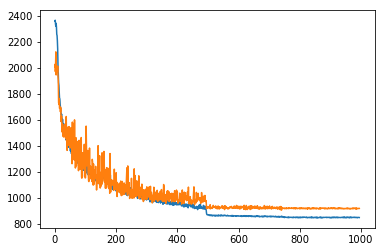

In [19]:
plt.plot(callback_list[1].history['train_loss'][5:])
plt.plot(callback_list[1].history['val_loss'][5:])

In [20]:
checkpoint = torch.load('../results/resnet/resnet-18-1c-wingloss.pth-best.tar')

## Loading the best model

In [21]:
from cpe775.utils.img_utils import show_landmarks_batch

In [23]:
net = resnet18(in_shape=(-1, 1, 256, 256), out_shape=(-1, 68, 2))

In [24]:
best_model = Model(net)
best_net = model.net
best_net.load_state_dict(checkpoint['state_dict'])

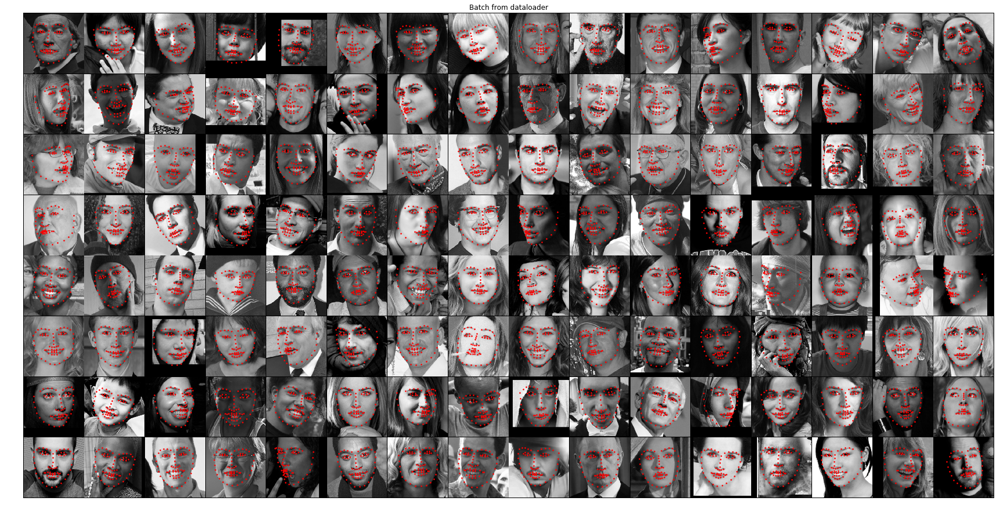

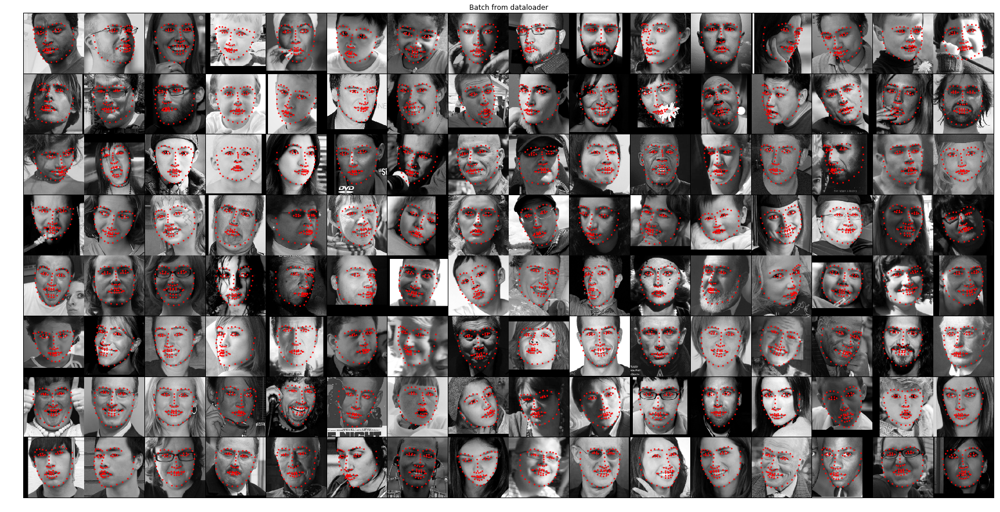

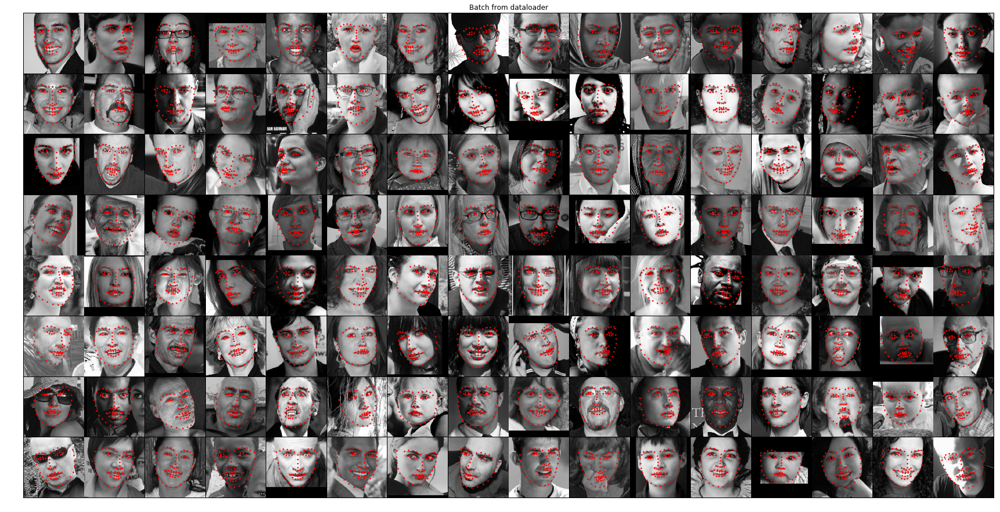

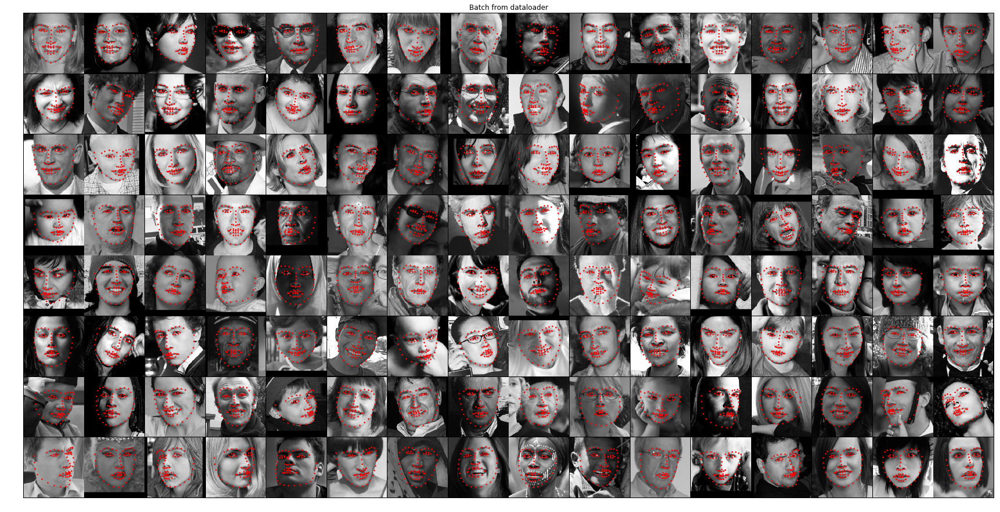

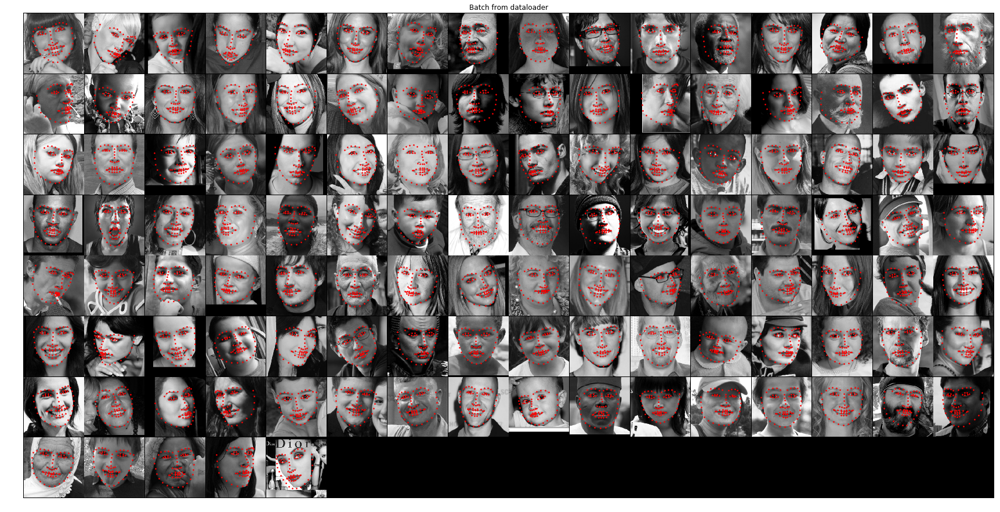

In [25]:
for i_batch, sample_batched in enumerate(valid_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data

    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)

    plt.axis('off')
    plt.ioff()
    plt.show()

### Common test

In [26]:
transforms = Compose([
                   CropFace(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [27]:
# load the dataset
dataset = FaceLandmarksDataset(csv_file='../data/common_test.csv',
                               root_dir='../data/',
                               transform=transforms)

common_loader = torch.utils.data.DataLoader(dataset, 
                batch_size=batch_size, num_workers=4)

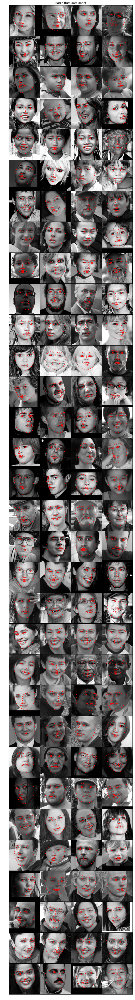

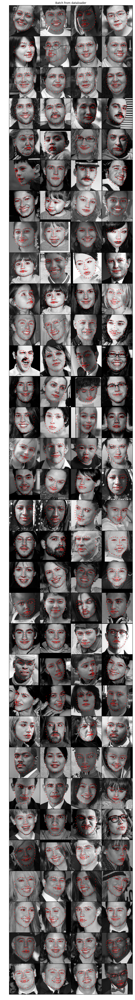

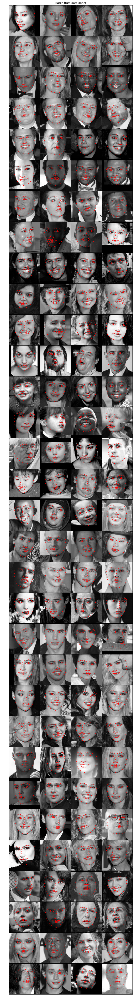

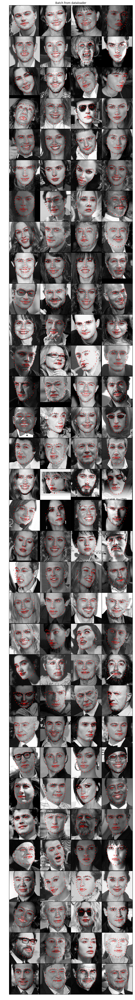

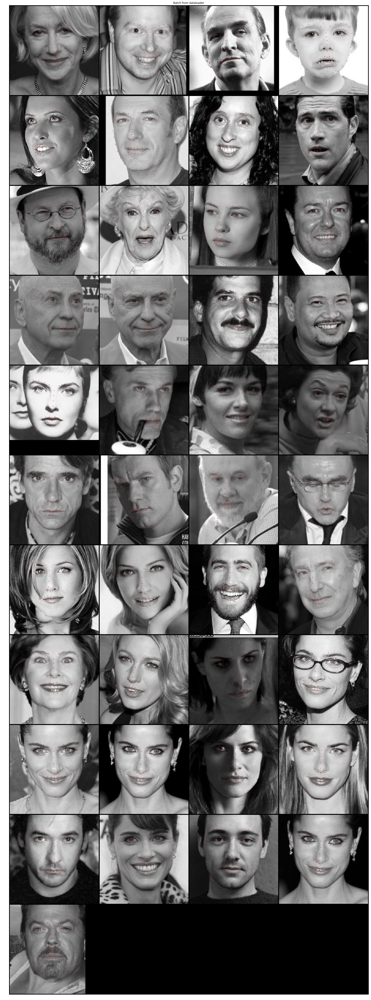

In [36]:
loss = 0
for i_batch, sample_batched in enumerate(common_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(60,80))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=4)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [29]:
loss/len(dataset)

869.7519398804815

### Challenging test

In [30]:
# load the dataset
challenging_set = FaceLandmarksDataset(csv_file='../data/challenging_test.csv',
                               root_dir='../data/',
                               transform=transforms)

challeging_loader = torch.utils.data.DataLoader(challenging_set, 
                batch_size=batch_size, num_workers=4)

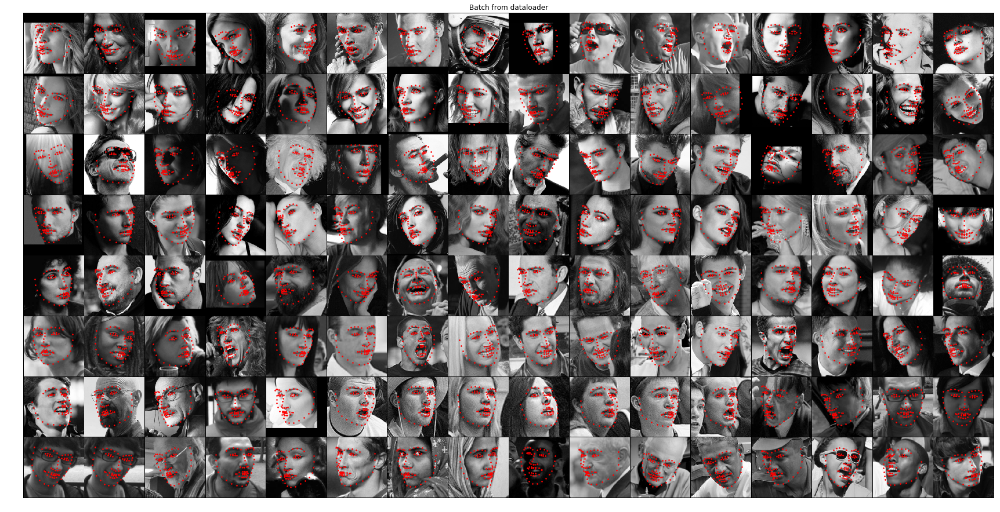

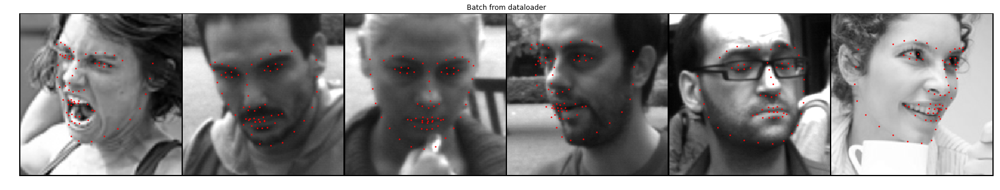

In [31]:
loss = 0
for i_batch, sample_batched in enumerate(challeging_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [32]:
loss/len(challenging_set)

1232.100610533757